In [4]:
!pip install -q ultralytics imutils

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 793.7/793.7 kB 13.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.3/21.3 MB 58.1 MB/s eta 0:00:00


In [5]:
from tqdm.auto import tqdm

import os
import requests
import zipfile
import cv2
import math
import matplotlib.pyplot as plt
import glob
import numpy as np
import random

from PIL import Image

In [6]:
ROOT_DIR = '/content/drive/MyDrive/hit-uav'
train_imgs_dir = '/content/drive/MyDrive/hit-uav/images/train'
train_labels_dir = '/content/drive/MyDrive/hit-uav/labels/train'
val_imgs_dir = '/content/drive/MyDrive/hit-uav/images/val'
val_labels_dir = '/content/drive/MyDrive/hit-uav/labels/val'
test_imgs_dir = '/content/drive/MyDrive/hit-uav/images/test'
test_labels_dir = '/content/drive/MyDrive/hit-uav/labels/test'
classes = ['Person', 'Car', 'Bicycle', 'OtherVechicle', 'DontCare']
colors = np.random.uniform(0, 255, size=(len(classes), 3))

In [7]:
def yolo2bbox(bboxes):
    xmin, ymin = bboxes[0]-bboxes[2]/2, bboxes[1]-bboxes[3]/2
    xmax, ymax = bboxes[0]+bboxes[2]/2, bboxes[1]+bboxes[3]/2
    return xmin, ymin, xmax, ymax

In [8]:
def plot_box(image, bboxes, labels, classes=classes, colors=colors, pos='above'):
    # Need the image height and width to denormalize
    # the bounding box coordinates
    height, width, _ = image.shape
    lw = max(round(sum(image.shape) / 2 * 0.003), 2)  # Line width.
    tf = max(lw - 1, 1) # Font thickness.
    for box_num, box in enumerate(bboxes):
        x1, y1, x2, y2 = yolo2bbox(box)
        # denormalize the coordinates
        xmin = int(x1*width)
        ymin = int(y1*height)
        xmax = int(x2*width)
        ymax = int(y2*height)

        p1, p2 = (int(xmin), int(ymin)), (int(xmax), int(ymax))

        class_name = classes[int(labels[box_num])]

        color=colors[classes.index(class_name)]

        cv2.rectangle(
            image,
            p1, p2,
            color=color,
            thickness=lw,
            lineType=cv2.LINE_AA
        )

        # For filled rectangle.
        w, h = cv2.getTextSize(
            class_name,
            0,
            fontScale=lw / 3,
            thickness=tf
        )[0]

        outside = p1[1] - h >= 3

        if pos == 'above':
            p2 = p1[0] + w, p1[1] - h - 3 if outside else p1[1] + h + 3
            cv2.rectangle(
                image,
                p1, p2,
                color=color,
                thickness=-1,
                lineType=cv2.LINE_AA
            )
            cv2.putText(
                image,
                class_name,
                (p1[0], p1[1] - 5 if outside else p1[1] + h + 2),
                cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=lw/3.5,
                color=(255, 255, 255),
                thickness=tf,
                lineType=cv2.LINE_AA
            )
        else:
            new_p2 = p1[0] + w, p2[1] + h + 3 if outside else p2[1] - h - 3
            cv2.rectangle(
                image,
                (p1[0], p2[1]), new_p2,
                color=color,
                thickness=-1,
                lineType=cv2.LINE_AA
            )
            cv2.putText(
                image,
                class_name,
                (p1[0], p2[1] + h + 2 if outside else p2[1]),
                cv2.FONT_HERSHEY_SIMPLEX,
                fontScale=lw/3,
                color=(255, 255, 255),
                thickness=tf,
                lineType=cv2.LINE_AA
            )
    return image

In [9]:
# Function to plot images with the bounding boxes.
def plot(image_path, label_path, num_samples, classes=classes, colors=colors, pos='above'):
    all_training_images = glob.glob(image_path+'/*')
    all_training_labels = glob.glob(label_path+'/*')
    all_training_images.sort()
    all_training_labels.sort()

    temp = list(zip(all_training_images, all_training_labels))
    random.shuffle(temp)
    all_training_images, all_training_labels = zip(*temp)
    all_training_images, all_training_labels = list(all_training_images), list(all_training_labels)

    num_images = len(all_training_images)

    if num_samples == -1:
        num_samples = num_images

    num_cols = 2
    num_rows = int(math.ceil(num_samples / num_cols))

    plt.figure(figsize=(10 * num_cols, 6 * num_rows))
    for i in range(num_samples):
        image_name = all_training_images[i].split(os.path.sep)[-1]
        image = cv2.imread(all_training_images[i])
        with open(all_training_labels[i], 'r') as f:
            bboxes = []
            labels = []
            label_lines = f.readlines()
            for label_line in label_lines:
                label, x_c, y_c, w, h = label_line.split(' ')
                x_c = float(x_c)
                y_c = float(y_c)
                w = float(w)
                h = float(h)
                bboxes.append([x_c, y_c, w, h])
                labels.append(label)
        result_image = plot_box(image, bboxes, labels, classes, colors, pos)
        plt.subplot(num_rows, num_cols, i+1) # Visualize 2x2 grid of images.
        plt.imshow(image[:, :, ::-1])
        plt.axis('off')
    plt.tight_layout()
    plt.show()

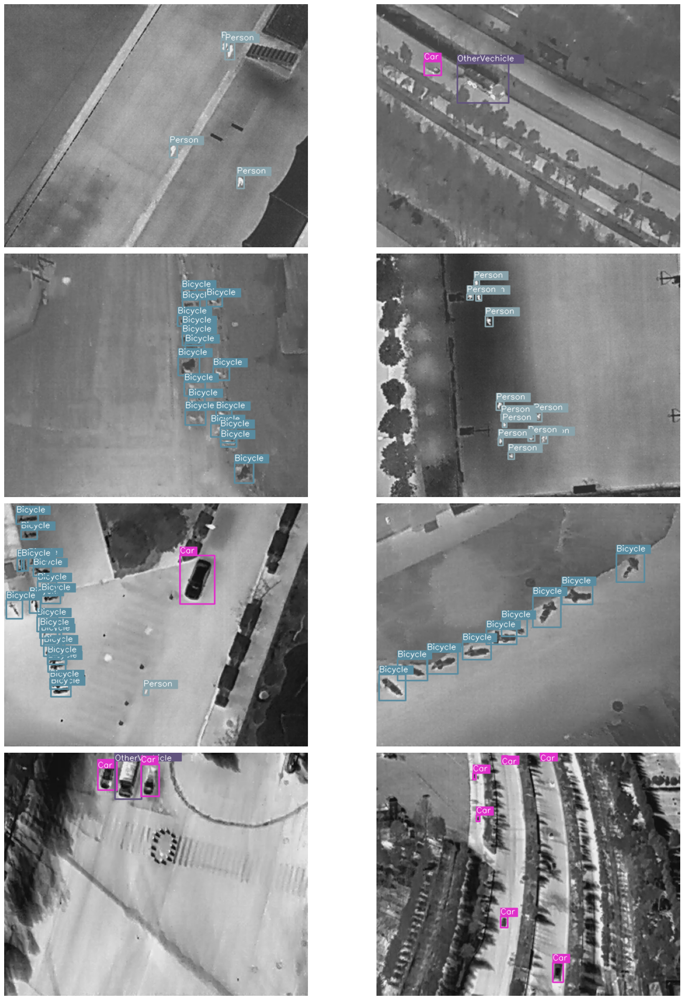

In [10]:
# Visualize a few training images.
plot(
    image_path=os.path.join(ROOT_DIR, train_imgs_dir),
    label_path=os.path.join(ROOT_DIR, train_labels_dir),
    num_samples=8
)

In [11]:
%%writefile dataset.yaml

path: /content/drive/MyDrive/hit-uav
train: /content/drive/MyDrive/hit-uav/images/train
val: /content/drive/MyDrive/hit-uav/images/val
test: /content/drive/MyDrive/hit-uav/images/test
names:
  0: Person
  1: Car
  2: Bicycle
  3: OtherVehicle
  4: DontCare
nc: 5

Writing dataset.yaml


In [12]:
import yaml

with open('dataset.yaml', 'r') as file:
    data = yaml.safe_load(file)

print(data)


{'path': '/content/drive/MyDrive/hit-uav', 'train': '/content/drive/MyDrive/hit-uav/images/train', 'val': '/content/drive/MyDrive/hit-uav/images/val', 'test': '/content/drive/MyDrive/hit-uav/images/test', 'names': {0: 'Person', 1: 'Car', 2: 'Bicycle', 3: 'OtherVehicle', 4: 'DontCare'}, 'nc': 5}


In [13]:
# Disable wandb
import os
os.environ['WANDB_DISABLED'] = 'true'

In [14]:
from ultralytics import YOLO
# Load a model
# model = YOLO("yolov8s.yaml")  # build a new model from scratch
model = YOLO("yolov8m.pt")  # load a pretrained model (recommended for training)

100%|██████████| 49.7M/49.7M [00:00<00:00, 488MB/s]


In [16]:
import os

val_image_dir = '/content/drive/MyDrive/hit-uav/images/val'
val_label_dir = val_image_dir.replace('images', 'labels')

image_files = os.listdir(val_image_dir)
missing_labels = []
empty_labels = []

for image_file in image_files:
    label_file = image_file.replace('.jpg', '.txt').replace('.png', '.txt')
    label_path = os.path.join(val_label_dir, label_file)
    if not os.path.exists(label_path):
        missing_labels.append(image_file)
    else:
        with open(label_path, 'r') as file:
            lines = file.readlines()
            if len(lines) == 0:
                empty_labels.append(label_file)

print(f'Missing label files: {len(missing_labels)}')
print(f'Empty label files: {len(empty_labels)}')

if missing_labels:
    print('Missing label files:', missing_labels)

if empty_labels:
    print('Empty label files:', empty_labels)


Missing label files: 0
Empty label files: 0


In [17]:
# Use the model
results = model.train(
   data='dataset.yaml',
   imgsz=512,
   epochs=50,
   batch=16,
   name='yolov8m_v8_50e'
)  # train the model

Ultralytics YOLOv8.2.48 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=dataset.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=512, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=yolov8m_v8_50e, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, show_boxes

100%|██████████| 755k/755k [00:00<00:00, 104MB/s]


Overriding model.yaml nc=80 with nc=5

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytics

100%|██████████| 6.25M/6.25M [00:00<00:00, 244MB/s]
/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


AMP: checks passed ✅


train: Scanning /content/drive/MyDrive/hit-uav/labels/train.cache... 2008 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2008/2008 [00:00<?, ?it/s]


albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /content/drive/MyDrive/hit-uav/labels/val.cache... 287 images, 0 backgrounds, 0 corrupt: 100%|██████████| 287/287 [00:00<?, ?it/s]


Plotting labels to runs/detect/yolov8m_v8_50e/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.001111, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 512 train, 512 val
Using 2 dataloader workers
Logging results to runs/detect/yolov8m_v8_50e
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      4.96G      1.668      1.619      1.102        135        512: 100%|██████████| 126/126 [11:38<00:00,  5.54s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.33it/s]

                   all        287       2460      0.561       0.37      0.391      0.195



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      4.88G      1.564      1.119      1.059        137        512: 100%|██████████| 126/126 [00:51<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.46it/s]

                   all        287       2460      0.681      0.394      0.472      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      4.81G      1.539      1.079      1.061        266        512: 100%|██████████| 126/126 [00:49<00:00,  2.53it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.50it/s]

                   all        287       2460       0.65      0.397      0.445      0.245



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      4.84G      1.533      1.029      1.056        141        512: 100%|██████████| 126/126 [00:50<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.55it/s]

                   all        287       2460      0.785      0.417      0.452      0.255



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      4.88G      1.504     0.9965      1.038        175        512: 100%|██████████| 126/126 [00:50<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.73it/s]

                   all        287       2460      0.755      0.428      0.485       0.26



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      4.88G       1.46     0.9445      1.038        113        512: 100%|██████████| 126/126 [00:51<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.06it/s]

                   all        287       2460      0.741      0.448      0.502       0.27



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      4.88G      1.437     0.9192      1.024        108        512: 100%|██████████| 126/126 [00:50<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.05it/s]

                   all        287       2460      0.705      0.502      0.554      0.317



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      4.87G      1.401     0.8695      1.011        123        512: 100%|██████████| 126/126 [00:51<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.53it/s]

                   all        287       2460      0.819      0.552      0.632       0.35



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      4.93G      1.368     0.8323      0.998        108        512: 100%|██████████| 126/126 [00:52<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.55it/s]

                   all        287       2460      0.748      0.524      0.596      0.343



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50      4.87G      1.357     0.8123     0.9983         96        512: 100%|██████████| 126/126 [00:53<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.49it/s]

                   all        287       2460       0.68      0.567      0.626      0.378



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      4.88G      1.361     0.8138      0.991        211        512: 100%|██████████| 126/126 [00:52<00:00,  2.39it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.30it/s]

                   all        287       2460      0.741      0.557      0.602      0.348



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      4.89G      1.326     0.7797     0.9904        151        512: 100%|██████████| 126/126 [00:51<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.66it/s]

                   all        287       2460      0.743      0.556      0.654      0.383



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      4.88G      1.325     0.7623     0.9779        115        512: 100%|██████████| 126/126 [00:50<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.42it/s]

                   all        287       2460      0.602      0.621      0.618      0.355



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      4.85G      1.318      0.746     0.9756        114        512: 100%|██████████| 126/126 [00:50<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.51it/s]

                   all        287       2460      0.718      0.575       0.63      0.389



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      4.86G      1.305     0.7482     0.9711         76        512: 100%|██████████| 126/126 [00:50<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.72it/s]

                   all        287       2460      0.572      0.502      0.584      0.359



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50      4.85G      1.277     0.7298     0.9708        132        512: 100%|██████████| 126/126 [00:51<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.14it/s]

                   all        287       2460      0.797      0.626      0.686      0.416



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50       4.9G      1.273     0.7196     0.9635        108        512: 100%|██████████| 126/126 [00:52<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.58it/s]

                   all        287       2460      0.849      0.668      0.715      0.426



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50      4.89G      1.262     0.6906      0.967         86        512: 100%|██████████| 126/126 [00:52<00:00,  2.38it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.58it/s]

                   all        287       2460      0.757      0.644      0.695      0.427



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      4.93G      1.256      0.698     0.9548        199        512: 100%|██████████| 126/126 [00:53<00:00,  2.36it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.49it/s]

                   all        287       2460      0.861      0.629      0.691      0.408



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      4.89G      1.237     0.6787     0.9565        133        512: 100%|██████████| 126/126 [00:53<00:00,  2.34it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.36it/s]

                   all        287       2460      0.658       0.64      0.642      0.403



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      4.87G      1.225     0.6746     0.9584        132        512: 100%|██████████| 126/126 [00:53<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.39it/s]

                   all        287       2460      0.755      0.604      0.671      0.417



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50      4.86G      1.216     0.6643     0.9492        139        512: 100%|██████████| 126/126 [00:53<00:00,  2.37it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.30it/s]

                   all        287       2460      0.718      0.582      0.661      0.424



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50      4.89G      1.215     0.6566     0.9433        141        512: 100%|██████████| 126/126 [00:52<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.62it/s]

                   all        287       2460      0.787       0.64       0.72      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50      4.85G      1.197     0.6516     0.9486        103        512: 100%|██████████| 126/126 [00:51<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.64it/s]

                   all        287       2460      0.828      0.651      0.711      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      4.88G      1.207     0.6464     0.9435         85        512: 100%|██████████| 126/126 [00:51<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.44it/s]

                   all        287       2460      0.842      0.689      0.749      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50      4.86G      1.175     0.6168     0.9331        178        512: 100%|██████████| 126/126 [00:51<00:00,  2.44it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.41it/s]

                   all        287       2460      0.796      0.699      0.728      0.438



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      4.93G      1.205     0.6406     0.9425         79        512: 100%|██████████| 126/126 [00:51<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.52it/s]

                   all        287       2460      0.818      0.666      0.708      0.451



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      4.88G      1.167     0.6127     0.9372        105        512: 100%|██████████| 126/126 [00:50<00:00,  2.50it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.56it/s]

                   all        287       2460      0.813      0.724      0.782      0.487



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50      4.86G      1.163     0.6083     0.9333        207        512: 100%|██████████| 126/126 [00:50<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.51it/s]

                   all        287       2460      0.817      0.666      0.731       0.46



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50      4.89G      1.148     0.6014     0.9334        107        512: 100%|██████████| 126/126 [00:50<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.56it/s]

                   all        287       2460      0.838      0.695      0.742      0.454



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      4.91G      1.128     0.5881     0.9228        171        512: 100%|██████████| 126/126 [00:50<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:06<00:00,  1.41it/s]

                   all        287       2460      0.835      0.714      0.738      0.458



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50       4.9G      1.123     0.5821     0.9177         97        512: 100%|██████████| 126/126 [00:50<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.55it/s]

                   all        287       2460      0.853      0.706      0.768      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      4.84G      1.117     0.5767     0.9244        114        512: 100%|██████████| 126/126 [00:51<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.92it/s]

                   all        287       2460      0.815       0.69      0.742      0.477



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      4.91G      1.111     0.5718     0.9165        197        512: 100%|██████████| 126/126 [00:51<00:00,  2.45it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.02it/s]

                   all        287       2460      0.811      0.695       0.74      0.465



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      4.91G      1.106     0.5672     0.9157         86        512: 100%|██████████| 126/126 [00:49<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.63it/s]

                   all        287       2460      0.801      0.741      0.775      0.479



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      4.87G      1.086     0.5471     0.9124        110        512: 100%|██████████| 126/126 [00:50<00:00,  2.48it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.86it/s]

                   all        287       2460      0.745       0.69      0.744      0.478



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      4.87G      1.078     0.5459     0.9112        162        512: 100%|██████████| 126/126 [00:51<00:00,  2.43it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.99it/s]

                   all        287       2460      0.823      0.693      0.731      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50      4.85G      1.076     0.5472     0.9099         76        512: 100%|██████████| 126/126 [00:51<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.65it/s]

                   all        287       2460      0.854      0.719       0.78      0.495



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      4.88G      1.082     0.5447     0.9126         59        512: 100%|██████████| 126/126 [00:50<00:00,  2.51it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.71it/s]

                   all        287       2460      0.785      0.709      0.744      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50      4.86G      1.059      0.534     0.9079         79        512: 100%|██████████| 126/126 [00:51<00:00,  2.46it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.25it/s]

                   all        287       2460      0.749      0.685      0.722      0.466


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/usr/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50      4.87G      1.072      0.523     0.9156         76        512: 100%|██████████| 126/126 [00:54<00:00,  2.33it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.60it/s]

                   all        287       2460      0.818      0.655      0.722      0.464



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      4.96G      1.055     0.5118     0.9056         43        512: 100%|██████████| 126/126 [00:49<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  2.02it/s]

                   all        287       2460      0.825      0.698      0.731      0.475



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      4.87G      1.043     0.5021     0.9047         40        512: 100%|██████████| 126/126 [00:49<00:00,  2.52it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.53it/s]

                   all        287       2460      0.816      0.691      0.734      0.476



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      4.95G      1.033      0.494     0.9013         96        512: 100%|██████████| 126/126 [00:50<00:00,  2.49it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.59it/s]

                   all        287       2460      0.795      0.678      0.737      0.485



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50         5G       1.03      0.491        0.9         76        512: 100%|██████████| 126/126 [00:52<00:00,  2.41it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.36it/s]

                   all        287       2460      0.789      0.706      0.743      0.481



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      4.84G      1.018     0.4859     0.9023         75        512: 100%|██████████| 126/126 [00:50<00:00,  2.47it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.74it/s]

                   all        287       2460      0.806      0.708      0.751      0.488



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      4.86G      1.007     0.4761     0.8944         62        512: 100%|██████████| 126/126 [00:49<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.60it/s]

                   all        287       2460      0.845      0.666      0.755      0.496



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      4.85G     0.9922     0.4671     0.8916         47        512: 100%|██████████| 126/126 [00:48<00:00,  2.59it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:05<00:00,  1.62it/s]

                   all        287       2460      0.815        0.7      0.754      0.494



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50      4.83G     0.9855     0.4636     0.8952         22        512: 100%|██████████| 126/126 [00:49<00:00,  2.56it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:04<00:00,  1.85it/s]

                   all        287       2460      0.899      0.719      0.783      0.492



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      4.83G     0.9843     0.4619     0.8876         49        512: 100%|██████████| 126/126 [00:49<00:00,  2.55it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:03<00:00,  2.25it/s]

                   all        287       2460      0.895      0.724      0.785      0.496



50 epochs completed in 0.988 hours.
Optimizer stripped from runs/detect/yolov8m_v8_50e/weights/last.pt, 52.0MB
Optimizer stripped from runs/detect/yolov8m_v8_50e/weights/best.pt, 52.0MB

Validating runs/detect/yolov8m_v8_50e/weights/best.pt...
Ultralytics YOLOv8.2.48 🚀 Python-3.10.12 torch-2.3.0+cu121 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 218 layers, 25842655 parameters, 0 gradients, 78.7 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 9/9 [00:09<00:00,  1.10s/it]


                   all        287       2460      0.895      0.724      0.784      0.494
                Person        171       1168      0.903      0.802      0.904      0.509
                   Car        136        719      0.955      0.974      0.985      0.777
               Bicycle         53        554      0.913      0.833      0.921      0.564
          OtherVehicle          9         12      0.858      0.583      0.683      0.541
              DontCare          5          7      0.844      0.429      0.428       0.08
Speed: 0.3ms preprocess, 5.8ms inference, 0.0ms loss, 3.5ms postprocess per image
Results saved to runs/detect/yolov8m_v8_50e


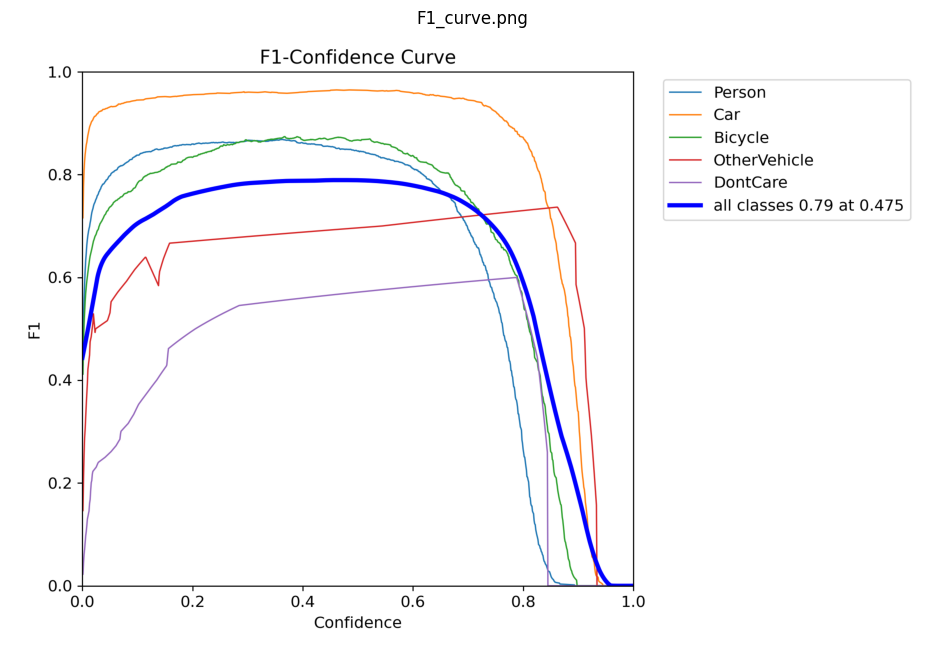

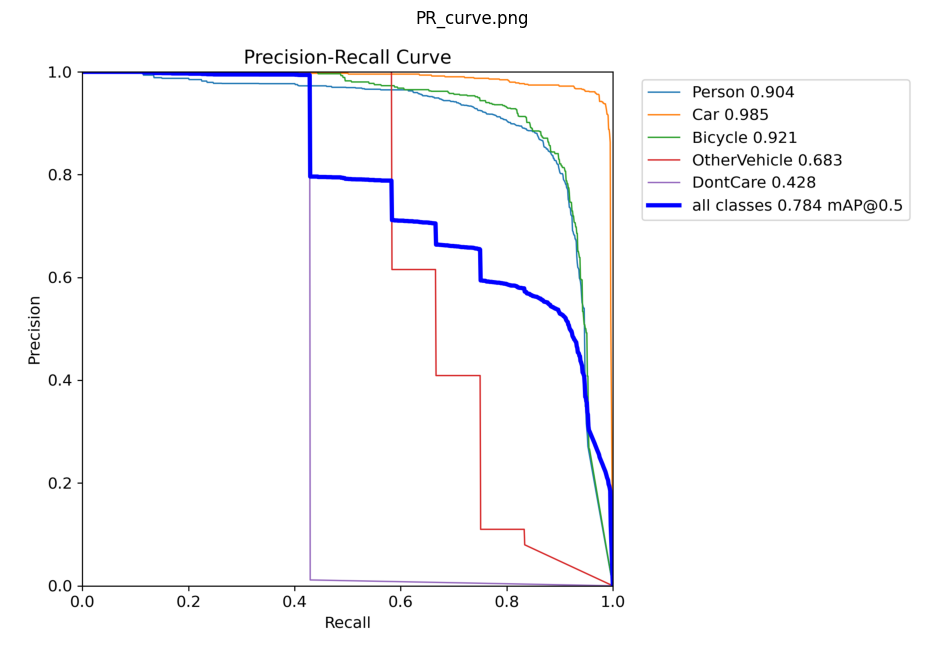

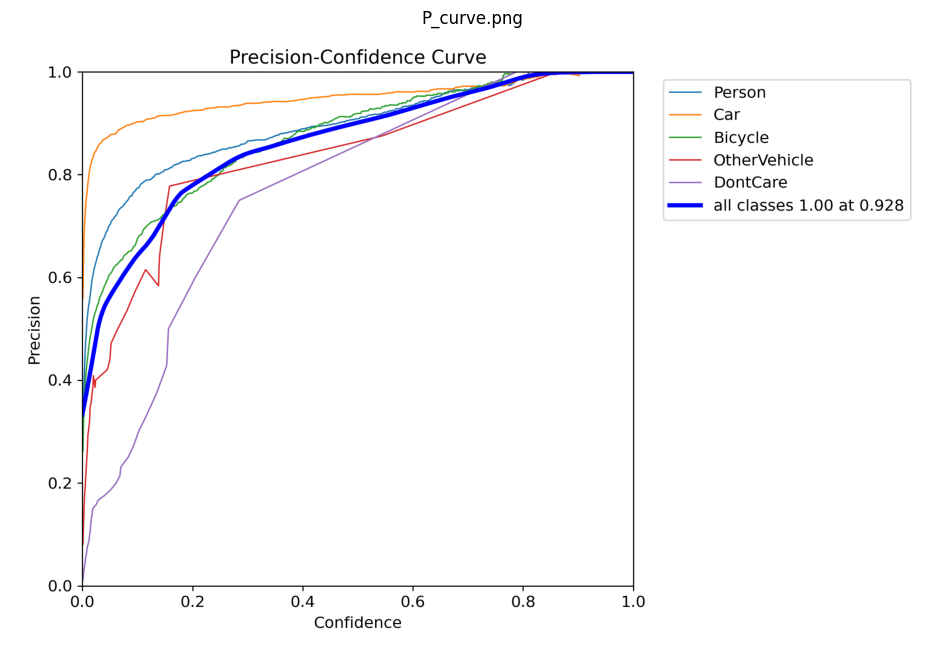

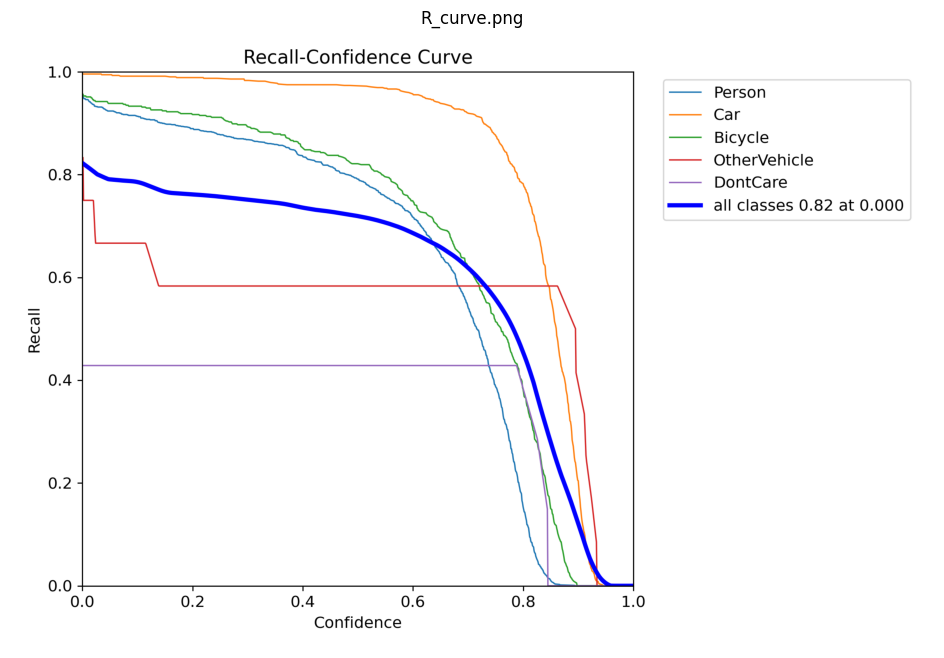

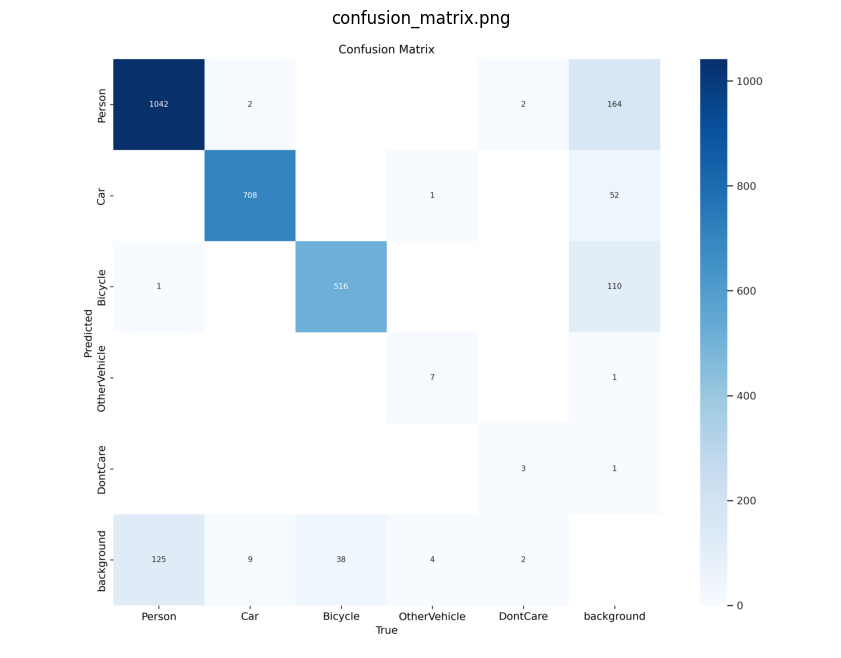

...

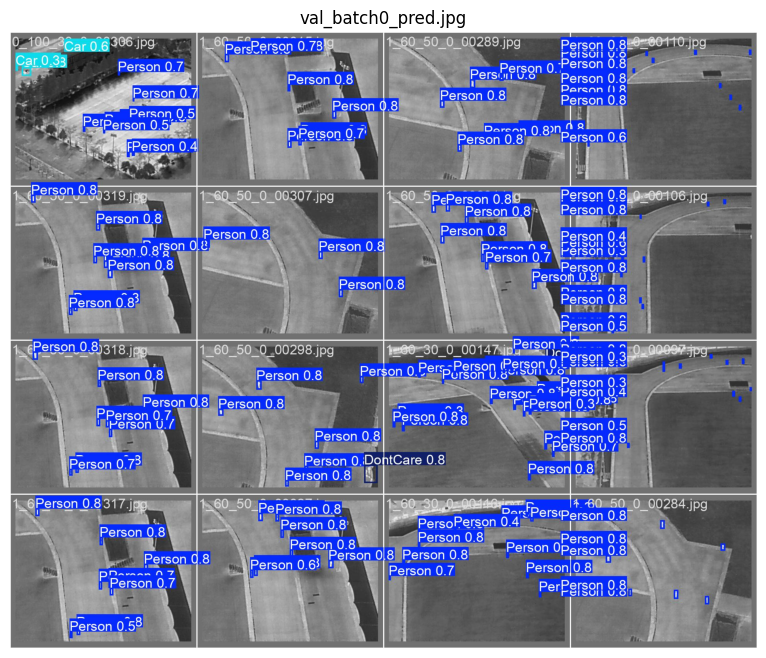

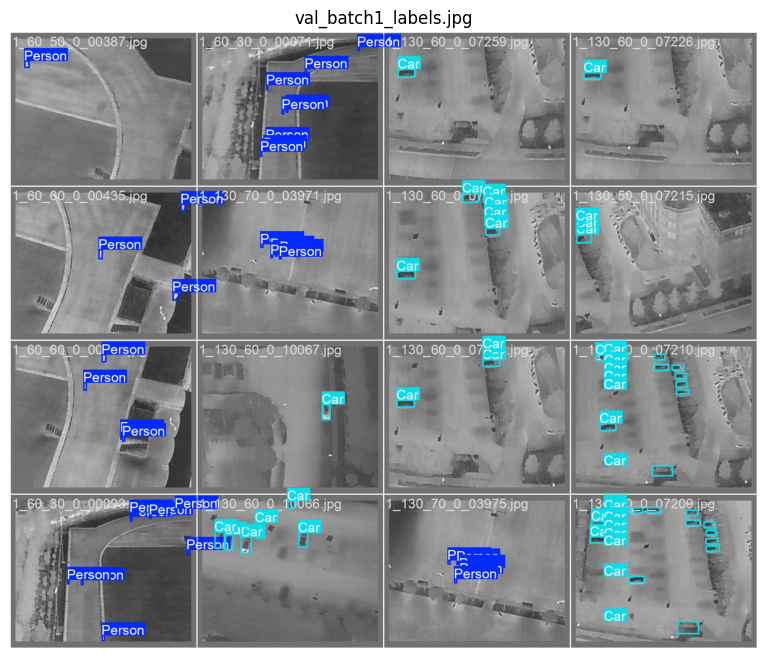

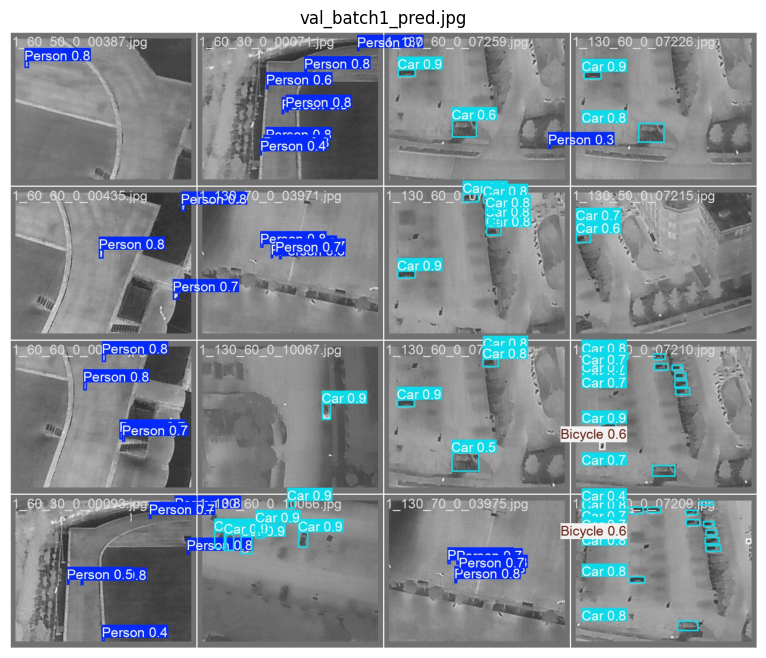

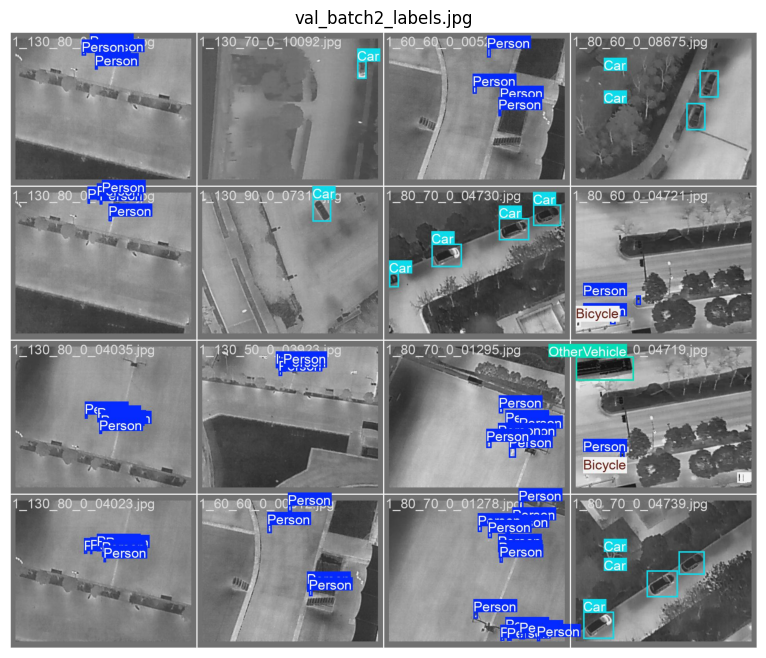

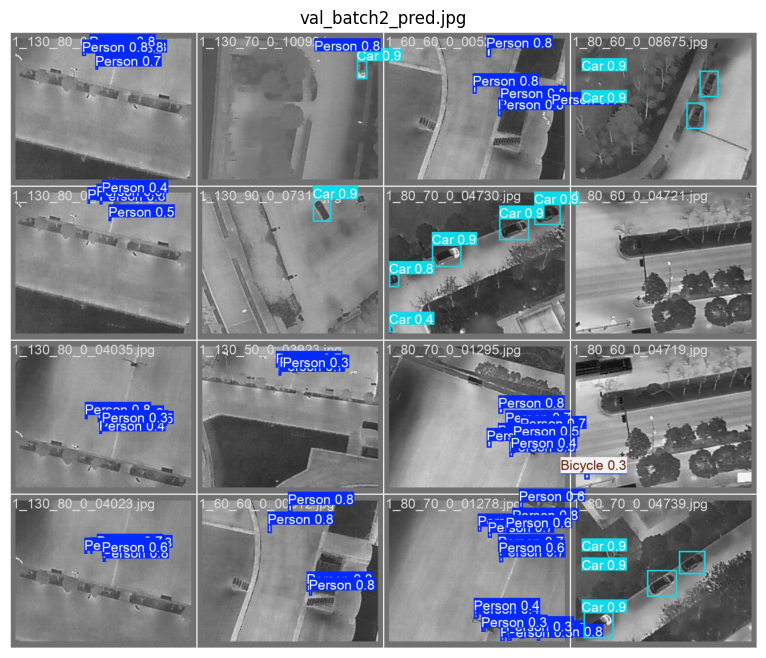

In [18]:
from imutils import paths

log_dir = "runs/detect/yolov8m_v8_50e"
for image_path in sorted(paths.list_images(log_dir)):
    image = Image.open(image_path)
    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(os.path.basename(image_path))
    plt.axis('off')
    plt.show()

In [19]:
results = model(os.path.join(ROOT_DIR, test_imgs_dir), conf=0.5, agnostic_nms=True, iou=0.5, save=True)


image 1/571 /content/drive/MyDrive/hit-uav/images/test/0_100_30_0_03307.jpg: 416x512 1 Person, 10 Cars, 486.1ms
image 2/571 /content/drive/MyDrive/hit-uav/images/test/0_100_30_0_08074.jpg: 416x512 8 Cars, 1 OtherVehicle, 37.3ms
image 3/571 /content/drive/MyDrive/hit-uav/images/test/0_100_30_0_08091.jpg: 416x512 10 Cars, 53.2ms
image 4/571 /content/drive/MyDrive/hit-uav/images/test/0_100_30_0_08100.jpg: 416x512 3 Cars, 89.6ms
image 5/571 /content/drive/MyDrive/hit-uav/images/test/0_100_40_0_03327.jpg: 416x512 3 Persons, 44.0ms
image 6/571 /content/drive/MyDrive/hit-uav/images/test/0_100_40_0_03332.jpg: 416x512 3 Persons, 23.8ms
image 7/571 /content/drive/MyDrive/hit-uav/images/test/0_100_40_0_03342.jpg: 416x512 2 Persons, 23.6ms
image 8/571 /content/drive/MyDrive/hit-uav/images/test/0_100_40_0_03347.jpg: 416x512 4 Persons, 23.6ms
image 9/571 /content/drive/MyDrive/hit-uav/images/test/0_100_40_0_08132.jpg: 416x512 2 Cars, 1 OtherVehicle, 23.7ms
image 10/571 /content/drive/MyDrive/hit-ua

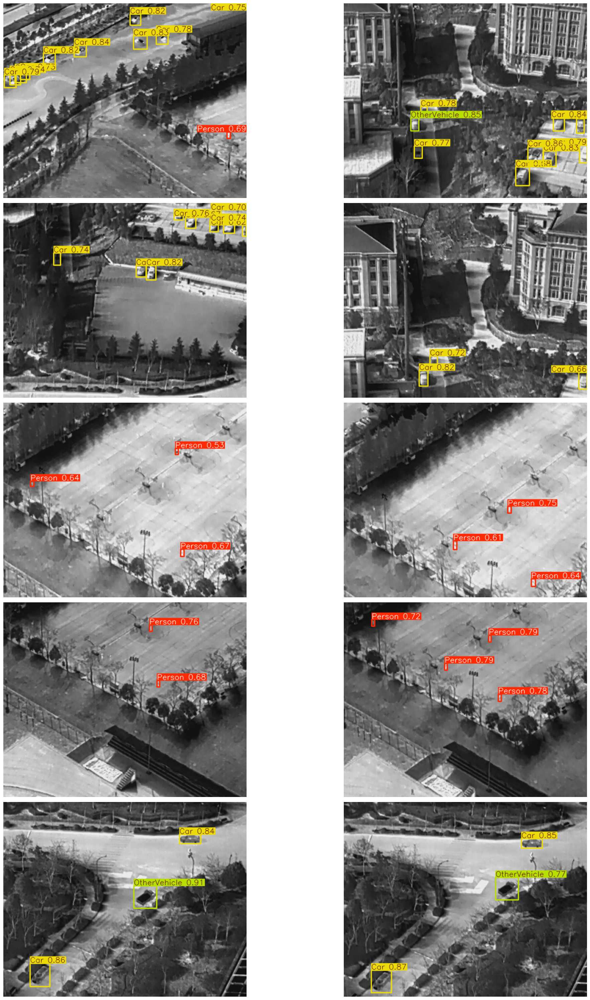

In [20]:
indices = list(range(len(results)))
random_indices = random.sample(indices, 10)
num_cols = 2
num_rows = 5

plt.figure(figsize=(12 * num_cols, 6 * num_rows))

for i, idx in enumerate(random_indices):
    image = results[i].plot()
    plt.subplot(num_rows, num_cols, i+1)
    plt.imshow(image)
    plt.axis('off')
plt.tight_layout()
plt.show()

In [21]:
ground_colors = [(255, 0, 0) for _ in range(len(classes))]

In [28]:
import locale
import subprocess

# Set locale to UTF-8
locale.setlocale(locale.LC_ALL, 'C.UTF-8')

# Run the command and capture the output
result = subprocess.run(['ls', '/content/runs/detect'], stdout=subprocess.PIPE, text=True)

# Print the output
print(result.stdout)


yolov8m_v8_50e
yolov8m_v8_50e2



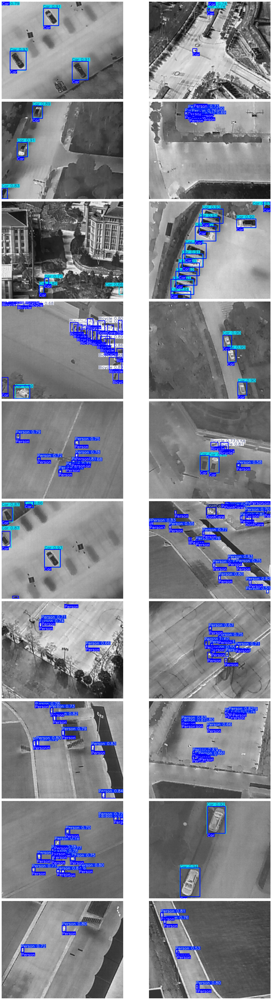

In [23]:
# Comparing a few testing images.
plot(
    image_path='/content/runs/detect/yolov8m_v8_50e2',
    label_path=os.path.join(ROOT_DIR, test_labels_dir),
    num_samples=20,
    classes=classes,
    colors=ground_colors,
    pos='below'
)